# Map making with Python!

## Import our libraries

In [23]:
import altair
import requests
import pandas
import geopandas
import json

## Altair Settings (Only for Juptyer Notebook)

In [24]:
altair.renderers.enable('notebook')
altair.themes.enable('opaque')

ThemeRegistry.enable('opaque')

## Test Altair

In [25]:
import altair
from vega_datasets import data

iris = data.iris()

altair.Chart(iris).mark_point().encode(
    x='sepalLength',
    y='sepalWidth',
    color='species'
)

In [26]:
iris.head()

,petalLength,petalWidth,sepalLength,sepalWidth,species
0,1.4,0.2,5.1,3.5,setosa
1,1.4,0.2,4.9,3.0,setosa
2,1.3,0.2,4.7,3.2,setosa
3,1.5,0.2,4.6,3.1,setosa
4,1.4,0.2,5.0,3.6,setosa


## Making Maps

In [27]:
def download_json(url):
    '''Downloads JSON file and Returns JSON'''
    url = "https://opendata.arcgis.com/datasets/bfe6977cfd574c2b894cd67cf6a787c3_2.geojson"
    repsonse = requests.get(url)
    return repsonse.json()


def read_json_file(path):
    '''Reads JSON file and Returns JSON'''
    with open(path, 'r') as json_file:
        return json.load(json_file)
        

def generate_base(geojson):
    '''Generates baselayer of map from altair data'''
    data = altair.Data(values=geojson)
    base = altair.Chart(data).mark_geoshape(
        stroke='blue',  # color of the lines
        strokeWidth=1    # the width of the lines
    ).encode(
    ).properties(
        width=400,       # total width of the map
        height=400       # height of the map
    )
    return base

### Downloads ANC JSON from Open Data DC and makes a Map

In [28]:
url = "https://opendata.arcgis.com/datasets/bfe6977cfd574c2b894cd67cf6a787c3_2.geojson"
anc_json = download_json(url)
base_layer = generate_base(geojson=anc_json)
base_layer

# Load our GeoJSON into a GeoPandas GeoDataFrame

In [29]:
geodataframe = geopandas.GeoDataFrame.from_features((anc_json))
geodataframe.head()

,ANC_ID,NAME,OBJECTID,SHAPE_Area,SHAPE_Length,WEB_URL,geometry
0,4C,ANC 4C,1,3.344032e+06,10341.699937,http://app.anc.dc.gov/wards.asp?ward=4&office=C,POLYGON ((-77.02801250848196 38.96126685738813...
1,4D,ANC 4D,2,1.842719e+06,6421.433702,http://app.anc.dc.gov/wards.asp?ward=4&office=D,POLYGON ((-77.01787596864135 38.95766774981324...
2,1B,ANC 1B,3,2.747224e+06,7418.871696,http://app.anc.dc.gov/wards.asp?ward=1&office=B,POLYGON ((-77.01824302717323 38.92852061963107...
3,2B,ANC 2B,4,2.160268e+06,7713.349828,http://app.anc.dc.gov/wards.asp?ward=2&office=B,POLYGON ((-77.03847471278722 38.91701117992299...
4,6B,ANC 6B,5,4.899464e+06,10778.799866,http://app.anc.dc.gov/wards.asp?ward=6&office=B,POLYGON ((-77.00591806003315 38.88981961048005...


# make a pandas dataframe from a CSV file

In [30]:
population_dataframe = pandas.read_csv('maps_data/population.csv')
population_dataframe.head()

,ANC_ID,pop_2000,pop_2010,pop_diff,pop_diff_perc
0,1A,21876,22457,581,0.027
1,1B,21640,25111,"3,471",0.160
2,1C,16437,16435,-2,0.000
3,1D,11794,10459,"-1,335",-0.113
4,2A,12744,17213,"4,470",0.351


# Then we will merge that dataframe with our geodataframe based on the location Id (ANC_ID)

In [31]:
geodataframe = geodataframe.merge(population_dataframe, on='ANC_ID', how='inner')
geodataframe.head()

,ANC_ID,NAME,OBJECTID,SHAPE_Area,SHAPE_Length,WEB_URL,geometry,pop_2000,pop_2010,pop_diff,pop_diff_perc
0,4C,ANC 4C,1,3.344032e+06,10341.699937,http://app.anc.dc.gov/wards.asp?ward=4&office=C,POLYGON ((-77.02801250848196 38.96126685738813...,19579,20330,751,0.038
1,4D,ANC 4D,2,1.842719e+06,6421.433702,http://app.anc.dc.gov/wards.asp?ward=4&office=D,POLYGON ((-77.01787596864135 38.95766774981324...,12341,12463,122,0.010
2,1B,ANC 1B,3,2.747224e+06,7418.871696,http://app.anc.dc.gov/wards.asp?ward=1&office=B,POLYGON ((-77.01824302717323 38.92852061963107...,21640,25111,"3,471",0.160
3,2B,ANC 2B,4,2.160268e+06,7713.349828,http://app.anc.dc.gov/wards.asp?ward=2&office=B,POLYGON ((-77.03847471278722 38.91701117992299...,17867,18117,249,0.014
4,6B,ANC 6B,5,4.899464e+06,10778.799866,http://app.anc.dc.gov/wards.asp?ward=6&office=B,POLYGON ((-77.00591806003315 38.88981961048005...,21364,23847,"2,483",0.116


In [32]:
# add the center lat and lon for each shape
geodataframe['centriod_lon'] = geodataframe['geometry'].centroid.x
geodataframe['centriod_lat'] = geodataframe['geometry'].centroid.y
geodataframe.head()

,ANC_ID,NAME,OBJECTID,SHAPE_Area,SHAPE_Length,WEB_URL,geometry,pop_2000,pop_2010,pop_diff,pop_diff_perc,centriod_lon,centriod_lat
0,4C,ANC 4C,1,3.344032e+06,10341.699937,http://app.anc.dc.gov/wards.asp?ward=4&office=C,POLYGON ((-77.02801250848196 38.96126685738813...,19579,20330,751,0.038,-77.027911,38.945261
1,4D,ANC 4D,2,1.842719e+06,6421.433702,http://app.anc.dc.gov/wards.asp?ward=4&office=D,POLYGON ((-77.01787596864135 38.95766774981324...,12341,12463,122,0.010,-77.018234,38.951656
2,1B,ANC 1B,3,2.747224e+06,7418.871696,http://app.anc.dc.gov/wards.asp?ward=1&office=B,POLYGON ((-77.01824302717323 38.92852061963107...,21640,25111,"3,471",0.160,-77.024453,38.921205
3,2B,ANC 2B,4,2.160268e+06,7713.349828,http://app.anc.dc.gov/wards.asp?ward=2&office=B,POLYGON ((-77.03847471278722 38.91701117992299...,17867,18117,249,0.014,-77.040645,38.908462
4,6B,ANC 6B,5,4.899464e+06,10778.799866,http://app.anc.dc.gov/wards.asp?ward=6&office=B,POLYGON ((-77.00591806003315 38.88981961048005...,21364,23847,"2,483",0.116,-76.987266,38.883534


In [33]:
## Now we convert our geodataframe back to geojson and pass it to altair.Data
geojson = json.loads(geodataframe.to_json())
geojson = geojson['features']

In [34]:
# RESERVA DEIT
choro_json = json.loads(geodataframe.to_json())
choro_data = altair.Data(values=choro_json['features'])

In [35]:
# verision 2 of generate_base which now included a title for the map
def generate_base(geojson, title):
    '''Generates baselayer of map from altair data'''
    data = altair.Data(values=geojson)
    base = altair.Chart(data, title=title).mark_geoshape(
        stroke='black',  # color of the lines
        strokeWidth=1    # the width of the lines
    ).encode(
    ).properties(
        width=400,       # total width of the map
        height=400       # height of the map
    )
    return base


generate_base(geojson, "My Map")

In [36]:
def generate_choropleth(geojson, color_column, legend_title):
    data = altair.Data(values=geojson)
    choropleth = altair.Chart(data).mark_geoshape(
        fill='lightgray',
        stroke='black',
        strokeWidth=1
    ).encode(
        altair.Color(color_column,  # change the color based on this column's values
                  type='quantitative', 
                  scale=altair.Scale(scheme='bluegreen'),
                  title=legend_title)
    )
       
    # Add Labels Layer
    labels = altair.Chart(choro_data).mark_text(baseline='top'
     ).properties(
        width=400,
        height=400
     ).encode(
         longitude='properties.centroid_lon:Q',
         latitude='properties.centroid_lat:Q',
         text='properties.DISTRICT:O',
         size=altair.value(8),
         opacity=altair.value(1)
     )
   
    return choropleth + labels

In [37]:
base_map_2000 = generate_base(geojson, title="2000")
population_map_2000 = generate_choropleth(geojson, color_column='properties.pop_2000', legend_title="DC Population")

population_map_2000 = base_map_2000 + population_map_2000

population_map_2000

In [17]:
base_map_2010 = generate_base(geojson, title="2010")
population_map_2010 = generate_choropleth(geojson, color_column='properties.pop_2010', legend_title="DC Population")

population_map_2010 = base_map_2010 + population_map_2010

population_map_2010

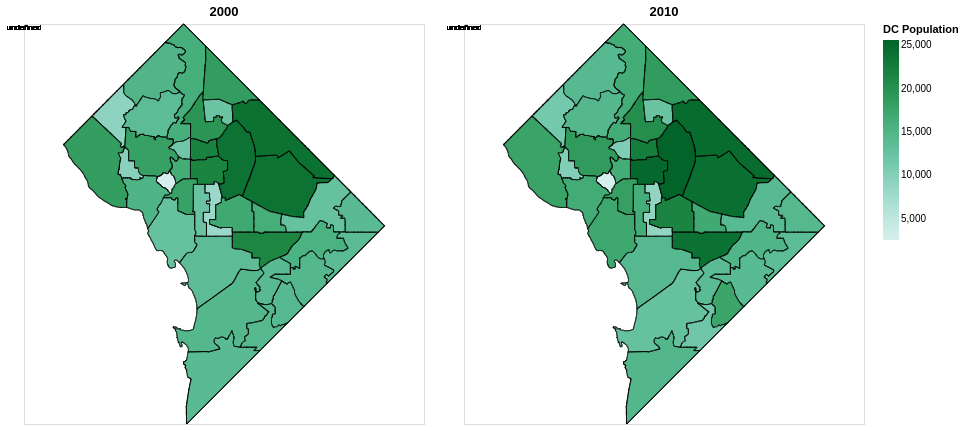

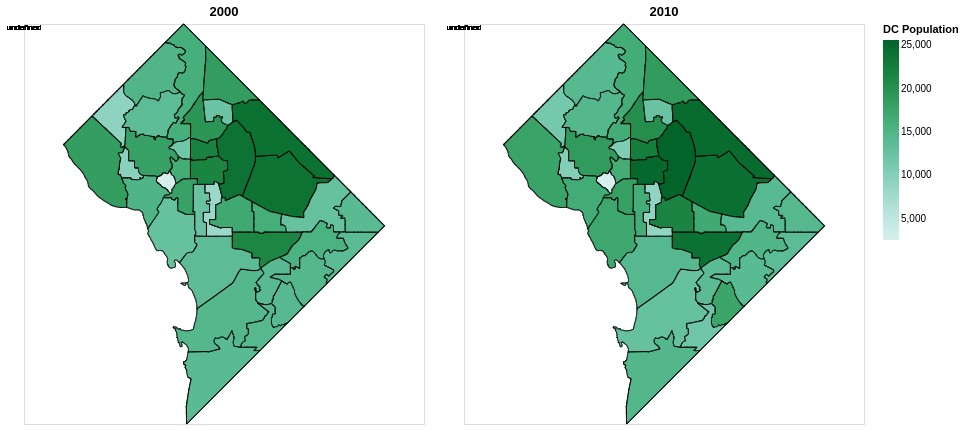

In [22]:
population_map_2000 | population_map_2010

## Mapping Timor

In [8]:
# Read geojson from file
geojson = read_json_file('maps_data/districts.geojson')

# Load our GeoJSON into a GeoPandas GeoDataFrame
geodataframe = geopandas.GeoDataFrame.from_features((geojson))
geodataframe.head()

,DISTR,DISTRICT,NEWDISCODE,geometry
0,DISTRITO DE AILEU,AILEU,2,POLYGON ((125.7706527709961 -8.587400436401367...
1,DISTRITO DE AINARO,AINARO,1,POLYGON ((125.6111907958984 -8.938739776611328...
2,DISTRITO DE BAUCAU,BAUCAU,3,POLYGON ((126.1930770874023 -8.573740005493164...
3,DISTRITO DE BOBONARO,BOBONARO,4,POLYGON ((125.0385131835938 -9.033220291137695...
4,DISTRITO DE COVALIMA,COVALIMA,5,POLYGON ((125.0958404541016 -9.201809883117676...


In [9]:
fake_population = [x * 13120 for x in list(range(1,14))]
PCODES = list(range(1,14))
data = {'NEWDISCODE': PCODES, 'fake_population': fake_population}

dataframe = pandas.DataFrame(data)
dataframe.head()

,NEWDISCODE,fake_population
0,1,13120
1,2,26240
2,3,39360
3,4,52480
4,5,65600


# merge our fake population into our geodataframe

In [10]:
geodata_frame = geodataframe.merge(dataframe, on='NEWDISCODE', how='inner')
geodata_frame.head()

,DISTR,DISTRICT,NEWDISCODE,geometry,fake_population
0,DISTRITO DE AILEU,AILEU,2,POLYGON ((125.7706527709961 -8.587400436401367...,26240
1,DISTRITO DE AINARO,AINARO,1,POLYGON ((125.6111907958984 -8.938739776611328...,13120
2,DISTRITO DE BAUCAU,BAUCAU,3,POLYGON ((126.1930770874023 -8.573740005493164...,39360
3,DISTRITO DE BOBONARO,BOBONARO,4,POLYGON ((125.0385131835938 -9.033220291137695...,52480
4,DISTRITO DE COVALIMA,COVALIMA,5,POLYGON ((125.0958404541016 -9.201809883117676...,65600


In [11]:
## Now we convert our geodataframe back to geojson
geojson = json.loads(geodata_frame.to_json())
geojson = geojson['features']

In [12]:
base_layer = generate_base(geojson=geojson, title="Timor-Leste")
base_layer

TypeError: generate_base() got an unexpected keyword argument 'title'

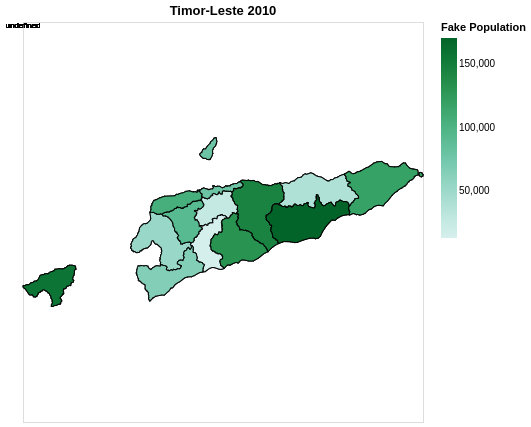

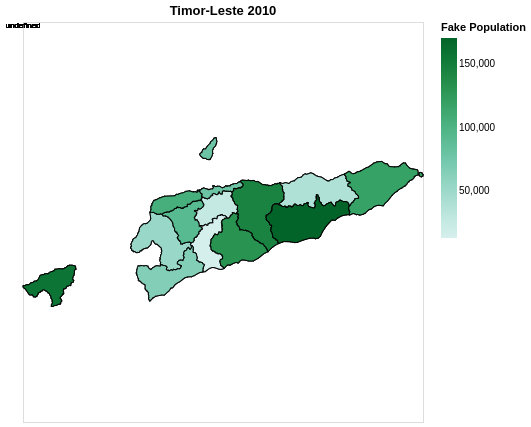

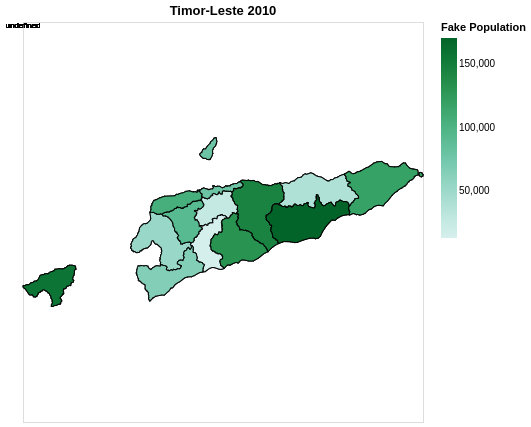

In [23]:
base_map_2010 = generate_base(geojson, title="Timor-Leste 2010")
fake_population_map = generate_choropleth(geojson, color_column='properties.fake_population', legend_title="Fake Population")
fake_population_map = base_map_2010 + fake_population_map
fake_population_map

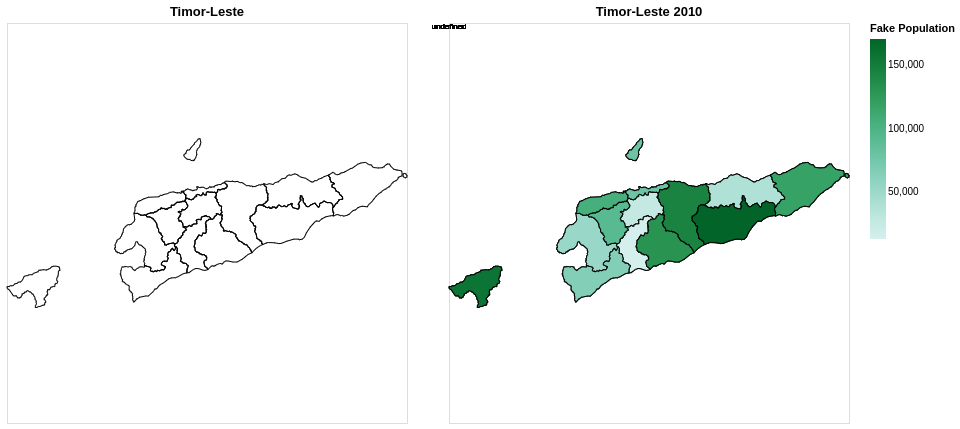

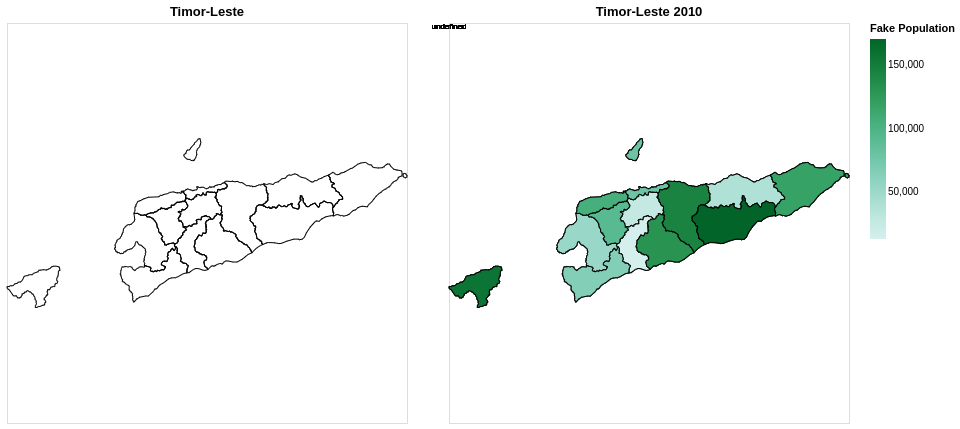

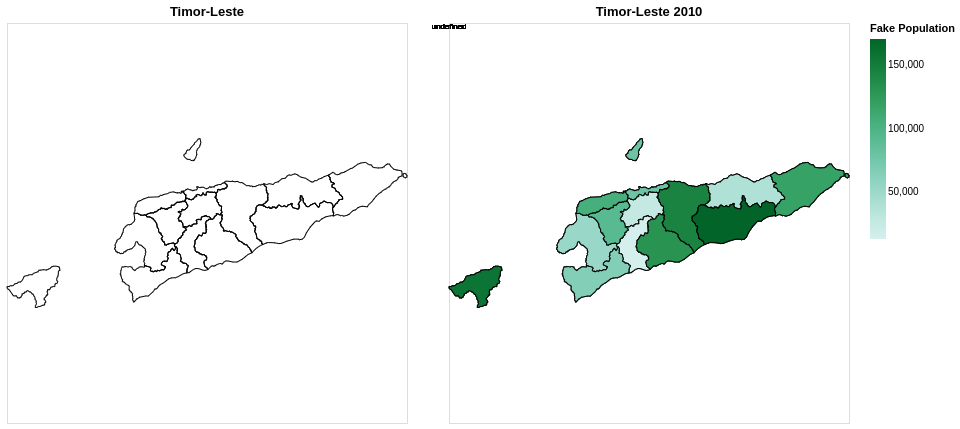

In [24]:
base_layer | fake_population_map

# Challenge: merging together two dataframe

In [1]:
# Read geojson from file
geojson = read_json_file('maps_data/districts.geojson')

# Load our GeoJSON into a GeoPandas GeoDataFrame
geodataframe = geopandas.GeoDataFrame.from_features((geojson))
geodataframe.head()

NameError: name 'read_json_file' is not defined

In [2]:
language_frame = pandas.read_csv('maps_data/lian.csv')
language_frame.head()

NameError: name 'pandas' is not defined

In [28]:
merge_dataframe = pandas.merge(geodataframe, language_frame, on='DISTRICT', how='inner')
merge_dataframe.head()

,DISTR,DISTRICT,NEWDISCODE,geometry,LIAN,LIAFUAN
0,DISTRITO DE AINARO,AINARO,1,POLYGON ((125.6111907958984 -8.938739776611328...,Mambae (Ainaro),Hato
1,DISTRITO DE BOBONARO,BOBONARO,4,POLYGON ((125.0385131835938 -9.033220291137695...,Kemak (Marobo),Hatu / Atsu
2,DISTRITO DE COVALIMA,COVALIMA,5,POLYGON ((125.0958404541016 -9.201809883117676...,English (Covalima),Stone / Rock
3,DISTRITO DE DILI,DILI,6,POLYGON ((125.7143630981445 -8.520219802856445...,Tetum (Dili),Fatuk
4,DISTRITO DE DILI,DILI,6,POLYGON ((125.6072769165039 -8.251099586486816...,Tetum (Dili),Fatuk


## Now we convert our geodataframe back to geojson

In [29]:
geojson = json.loads(merge_dataframe.to_json())
geojson = geojson['features']

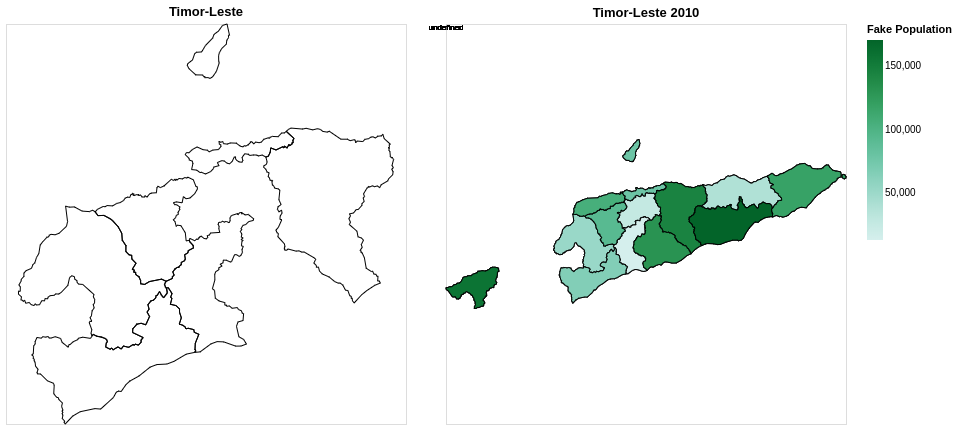

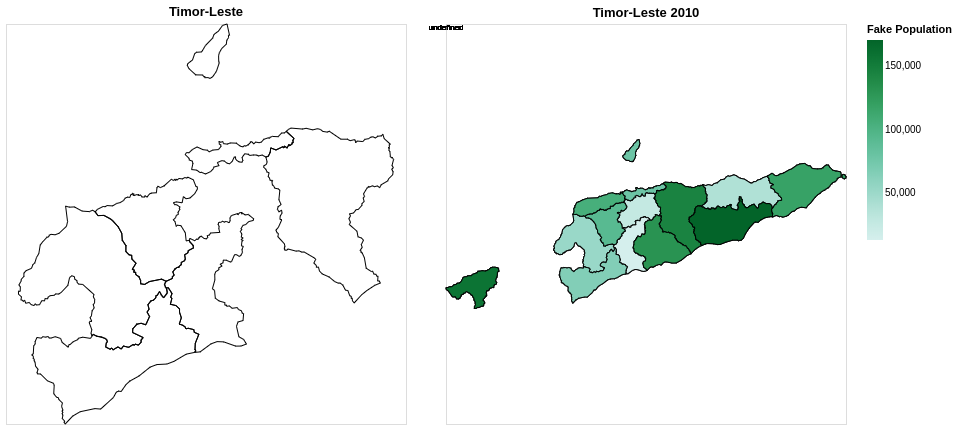

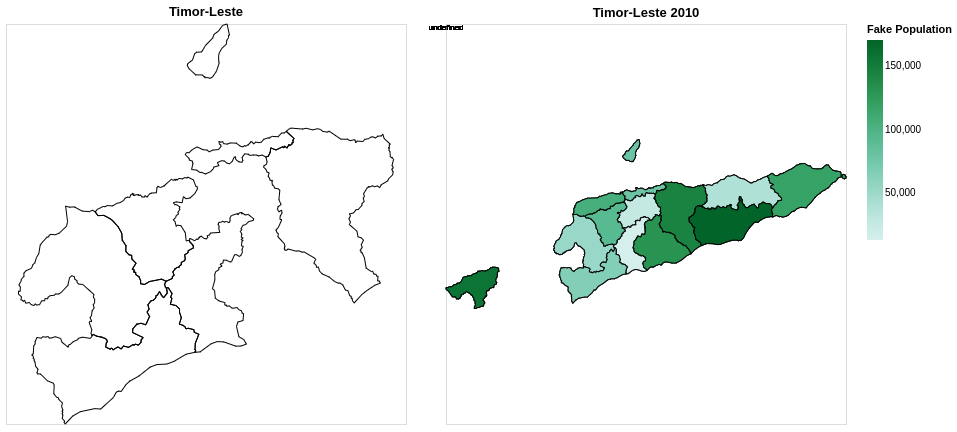

In [30]:
base_layer = generate_base(geojson=geojson, title="Timor-Leste")
base_layer | fake_population_map

# Example merge together two dataframes

In [31]:
# import the pandas library
import pandas as pd

first_dataframe = pd.DataFrame({
   'ID':[1, 2, 3, 4, 5],
   'Languages': ['Kemak', 'Mambae', 'Galolen', 'Tokodede', 'Makasae']
})
first_dataframe

,ID,Languages
0,1,Kemak
1,2,Mambae
2,3,Galolen
3,4,Tokodede
4,5,Makasae


In [32]:
second_dataframe = pd.DataFrame({
   'ID':[1, 2, 3, 4, 7],
   'Municipality': ['Bbobnaro', 'Ermera', 'Manatuto', 'Liquisa', 'Baucau']
})
second_dataframe

,ID,Municipality
0,1,Bbobnaro
1,2,Ermera
2,3,Manatuto
3,4,Liquisa
4,7,Baucau


In [33]:
merge_dataframe = pd.merge(first_dataframe, second_dataframe, on='ID', how='inner')
merge_dataframe.head()

,ID,Languages,Municipality
0,1,Kemak,Bbobnaro
1,2,Mambae,Ermera
2,3,Galolen,Manatuto
3,4,Tokodede,Liquisa
